In [3]:
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt

from src.settings import POLISH_ANNOTATIONS_FPATH, PREPRO_ANNOTATIONS_DIR, DATA_DIR

In [31]:
from datetime import datetime

datetime.strftime(datetime.now(), '%Y%m%d_%H%M%Sf%f')

'20240128_165507f927570'

## Polish annotations

In [4]:
pl_ann_df = pd.read_json(POLISH_ANNOTATIONS_FPATH, lines=True)
pl_ann_df

,start,end,text,doc_filepath,video_filename,task_label
0,39040,41120,"Myślę, że mam inny pomysł, można?",/15/K66BF13-26_15_15_signsNO.eaf,K66BF13-26.mp4,15
1,41120,49680,"Chyba ten znak mówi, że jak ktoś będzie spacer...",/15/K66BF13-26_15_15_signsNO.eaf,K66BF13-26.mp4,15
2,49680,55280,Trzeba przejść łukiem obok leżącego i o tym zn...,/15/K66BF13-26_15_15_signsNO.eaf,K66BF13-26.mp4,15
3,61280,66840,"Okrągły znak pomaga nam, mówi, że są pasy na u...",/15/K66BF13-26_15_15_signsNO.eaf,K66BF13-26.mp4,15
4,66840,73200,"Jak ktoś zobaczy, ale zignoruje ten znak, to m...",/15/K66BF13-26_15_15_signsNO.eaf,K66BF13-26.mp4,15
...,...,...,...,...,...,...
40350,248960,250320,[uderzanie w coś],/13/K17BF13-26_13_13_comics.eaf,K17BF13-26.mp4,13
40351,279560,291400,Kot zobaczył w akwarium rybkę. Podszedł i dał ...,/13/K17BF13-26_13_13_comics.eaf,K17BF13-26.mp4,13
40352,291400,347120,"Zjadłam, zjadłam.",/13/K17BF13-26_13_13_comics.eaf,K17BF13-26.mp4,13
40353,347120,356440,"Zając biegnie, zobaczył wiszące pranie. Wskocz...",/13/K17BF13-26_13_13_comics.eaf,K17BF13-26.mp4,13


In [6]:
from transformers import pipeline

ner = pipeline('ner', model='clarin-pl/FastPDN', aggregation_strategy='simple', device="cuda")

In [6]:
pl_ann_results = ner(pl_ann_df["text"].tolist())

In [9]:
list(filter(lambda x: any(x), pl_ann_results))[:5]

[[{'entity_group': 'nam_loc_gpe_city',
   'score': 0.99733114,
   'word': 'Bar',
   'start': 0,
   'end': 3}],
 [{'entity_group': 'nam_loc_gpe_country',
   'score': 0.9997974,
   'word': 'Włoch',
   'start': 26,
   'end': 31}],
 [{'entity_group': 'nam_loc_gpe_country',
   'score': 0.9997178,
   'word': 'Włoch',
   'start': 23,
   'end': 28}],
 [{'entity_group': 'nam_loc_gpe_city',
   'score': 0.9396633,
   'word': 'Watykanie',
   'start': 31,
   'end': 40}],
 [{'entity_group': 'nam_liv_person',
   'score': 0.9051755,
   'word': 'Koszula',
   'start': 0,
   'end': 7}]]

In [17]:
from itertools import chain
from jsonlines import jsonlines

with jsonlines.open(PREPRO_ANNOTATIONS_DIR / "pl_ann__fastpdn.jsonl", "w") as writer:
    for entity_record in chain.from_iterable(filter(lambda x: any(x), pl_ann_results)):
        entity_record["score"] = float(entity_record["score"])
        writer.write(entity_record)

In [18]:
pl_ann_ner_results_df = pd.DataFrame.from_records(chain.from_iterable(filter(lambda x: any(x), results)))
pl_ann_ner_results_df

,entity_group,score,word,start,end
0,nam_loc_gpe_city,0.997331,Bar,0,3
1,nam_loc_gpe_country,0.999797,Włoch,26,31
2,nam_loc_gpe_country,0.999718,Włoch,23,28
3,nam_loc_gpe_city,0.939663,Watykanie,31,40
4,nam_liv_person,0.905176,Koszula,0,7
...,...,...,...,...,...
3292,nam_liv_person,0.892511,Disneya,32,39
3293,nam_org_company,0.757079,Disney,0,6
3294,nam_org_company,0.757079,Disney,0,6
3295,nam_liv_person,0.489626,Miś,0,3


## DiaBiz

In [5]:
diabiz_df = pd.read_csv(DATA_DIR / "all_calls_texts_per_channel.csv", index_col=0)
diabiz_df

,text,channel,source_file,call
1,(yy) Dzień... dzień dobry pani. (yy) Ja dzwoni...,clnt,cbiz_tc_1.clnt.txt,cbiz_tc_1
2,"(...) Dobry, Anna Kwiatkowska, Nowy Bank. W cz...",cbiz_tc_1,cbiz_tc_1.txt,cbiz_tc_1
3,Kwiatkowska. Przychodnia MedMed. W czym mogę p...,agnt,cbiz_tc_10.agnt.txt,cbiz_tc_10
4,"Dzień dobry pani. Ja tutaj zadzwonię do pani, ...",clnt,cbiz_tc_10.clnt.txt,cbiz_tc_10
5,Kwiatkowska. Przychodnia MedMed. W czym mogę p...,cbiz_tc_10,cbiz_tc_10.txt,cbiz_tc_10
...,...,...,...,...
12025,"(yy) Dzień dobry. Proszę pana, (yy) nie mogę s...",clnt,cbiz_tc_994.clnt.txt,cbiz_tc_994
12026,Dzień dobry. Mikołaj Dębek. Biuro obsługi klie...,cbiz_tc_994,cbiz_tc_994.txt,cbiz_tc_994
12027,"Dzień dobry, Andrzej Kwaśniak, Biuro Obsługi K...",agnt,cbiz_tc_995.agnt.txt,cbiz_tc_995
12028,"(yy) Dzień dobry, Michał Flagowy z tej strony....",clnt,cbiz_tc_995.clnt.txt,cbiz_tc_995


In [8]:
diabiz_ner_results = ner(diabiz_df["text"].tolist())

In [9]:
from itertools import chain
from jsonlines import jsonlines

with jsonlines.open(PREPRO_ANNOTATIONS_DIR / "diabiz__fastpdn.jsonl", "w") as writer:
    for entity_record in chain.from_iterable(filter(lambda x: any(x), diabiz_ner_results)):
        entity_record["score"] = float(entity_record["score"])
        writer.write(entity_record)

In [10]:
diabiz_ner_results_df = pd.DataFrame.from_records(
    chain.from_iterable(filter(lambda x: any(x), diabiz_ner_results))
)
diabiz_ner_results_df

,entity_group,score,word,start,end
0,nam_liv_person,0.999679,Cezary Pazura,102,115
1,nam_liv_person,0.999735,Anna Kwiatkowska,13,29
2,nam_org_company,0.740261,Nowy Bank,31,40
3,nam_adj,0.796877,internetowego,139,152
4,nam_liv_person,0.999419,Cezary Pazura,470,483
...,...,...,...,...,...
74174,nam_oth,0.569872,PESEL,1122,1127
74175,nam_oth,0.541119,PESEL,1652,1657
74176,nam_fac_road,0.999014,Ol,1871,1873
74177,nam_fac_road,0.911875,szowa,1873,1878


# Corpora comparision - NER

In [135]:
label_meaning_mapping = {
    "nam_loc": "Nazwy lokalizacji, obiektów\ngeopolitycznych i geograficznych",
    "nam_liv": "Nazwy istot żywych",
    "nam_org": "Nazwy organizacji",
    "nam_fac": "Nazwy budowli stworzonych\nprzez człowieka",
    "nam_pro": "Nazwy produktów",
    "nam_oth": "Pozostałe nazwy niezaklasyfikowane\ndo pozostałych grup",
    "nam_eve": "Nazwy wydarzeń",
    "nam_adj": "Przymiotniki pochodzące\nod nazw własnych",
    "nam_num": "Etykiety numeryczne",
}

In [11]:
pl_ann_ner_results_df = pd.read_json(PREPRO_ANNOTATIONS_DIR / "pl_ann__fastpdn.jsonl", lines=True)
pl_ann_ner_results_df

,entity_group,score,word,start,end
0,nam_loc_gpe_city,0.997331,Bar,0,3
1,nam_loc_gpe_country,0.999797,Włoch,26,31
2,nam_loc_gpe_country,0.999718,Włoch,23,28
3,nam_loc_gpe_city,0.939663,Watykanie,31,40
4,nam_liv_person,0.905176,Koszula,0,7
...,...,...,...,...,...
3292,nam_liv_person,0.892511,Disneya,32,39
3293,nam_org_company,0.757079,Disney,0,6
3294,nam_org_company,0.757079,Disney,0,6
3295,nam_liv_person,0.489626,Miś,0,3


In [12]:
pl_ann_ner_results_df["entity_group"].nunique()

51

In [26]:
pl_ann_ner_results_df["short_entity_group"] = pl_ann_ner_results_df["entity_group"].str.extract(r"([a-z]+_[a-z]+)")
pl_ann_ner_results_df

,entity_group,score,word,start,end,short_entity_group
0,nam_loc_gpe_city,0.997331,Bar,0,3,nam_loc
1,nam_loc_gpe_country,0.999797,Włoch,26,31,nam_loc
2,nam_loc_gpe_country,0.999718,Włoch,23,28,nam_loc
3,nam_loc_gpe_city,0.939663,Watykanie,31,40,nam_loc
4,nam_liv_person,0.905176,Koszula,0,7,nam_liv
...,...,...,...,...,...,...
3292,nam_liv_person,0.892511,Disneya,32,39,nam_liv
3293,nam_org_company,0.757079,Disney,0,6,nam_org
3294,nam_org_company,0.757079,Disney,0,6,nam_org
3295,nam_liv_person,0.489626,Miś,0,3,nam_liv


In [27]:
pl_ann_ner_results_df["short_entity_group"].nunique()

8

In [136]:
pl_ann_ner_results_df["entity_human_readable"] = pl_ann_ner_results_df["short_entity_group"].map(label_meaning_mapping)

In [39]:
diabiz_ner_results_df = pd.read_json(PREPRO_ANNOTATIONS_DIR / "diabiz__fastpdn.jsonl", lines=True)
diabiz_ner_results_df

,entity_group,score,word,start,end
0,nam_liv_person,0.999679,Cezary Pazura,102,115
1,nam_liv_person,0.999735,Anna Kwiatkowska,13,29
2,nam_org_company,0.740261,Nowy Bank,31,40
3,nam_adj,0.796877,internetowego,139,152
4,nam_liv_person,0.999419,Cezary Pazura,470,483
...,...,...,...,...,...
74174,nam_oth,0.569872,PESEL,1122,1127
74175,nam_oth,0.541119,PESEL,1652,1657
74176,nam_fac_road,0.999014,Ol,1871,1873
74177,nam_fac_road,0.911875,szowa,1873,1878


In [40]:
diabiz_ner_results_df["entity_group"].nunique()

71

In [43]:
diabiz_ner_results_df["short_entity_group"] = diabiz_ner_results_df["entity_group"].str.extract(r"([a-z]+_[a-z]+)")
diabiz_ner_results_df

,entity_group,score,word,start,end,short_entity_group
0,nam_liv_person,0.999679,Cezary Pazura,102,115,nam_liv
1,nam_liv_person,0.999735,Anna Kwiatkowska,13,29,nam_liv
2,nam_org_company,0.740261,Nowy Bank,31,40,nam_org
3,nam_adj,0.796877,internetowego,139,152,nam_adj
4,nam_liv_person,0.999419,Cezary Pazura,470,483,nam_liv
...,...,...,...,...,...,...
74174,nam_oth,0.569872,PESEL,1122,1127,nam_oth
74175,nam_oth,0.541119,PESEL,1652,1657,nam_oth
74176,nam_fac_road,0.999014,Ol,1871,1873,nam_fac
74177,nam_fac_road,0.911875,szowa,1873,1878,nam_fac


In [44]:
diabiz_ner_results_df["short_entity_group"].nunique()

9

In [137]:
diabiz_ner_results_df["entity_human_readable"] = diabiz_ner_results_df["short_entity_group"].map(label_meaning_mapping)

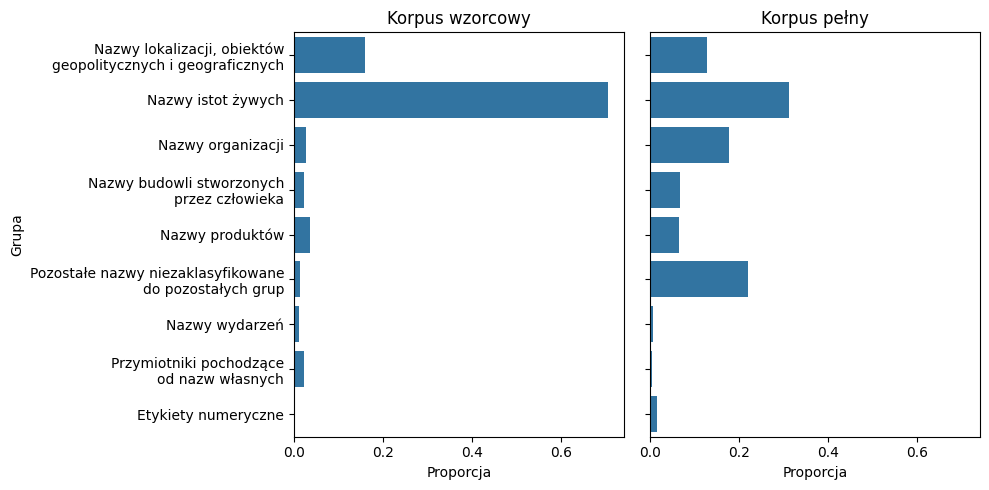

In [138]:
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharey=True, sharex=True, figsize=(10, 5))

sns.countplot(
    # y="short_entity_group",
    y="entity_human_readable",
    stat="proportion",
    data=pl_ann_ner_results_df,
    ax=ax1
)
sns.countplot(
    # y="short_entity_group",
    y="entity_human_readable",
    stat="proportion",
    data=diabiz_ner_results_df,
    ax=ax2
)
ax1.set_title("Korpus wzorcowy")
ax2.set_title("Korpus pełny")
ax1.set_xlabel("Proporcja")
ax2.set_xlabel("Proporcja")
ax1.set_ylabel("Grupa")
plt.tight_layout()
plt.show()

## Corpora comparision - sentiment

In [94]:
from transformers import pipeline

sentiment_model = pipeline(task="text-classification", model="eevvgg/sentimenTw-political", tokenizer="eevvgg/sentimenTw-political", top_k=None, device="cuda")

model_output = sentiment_model("Nigdy przegrana nie sprawiła mi takiej radości. Szczęście i Opatrzność mają znaczenie Gratuluje @pzpn_pl")
model_output

[[{'label': 'positive', 'score': 0.9939236044883728},
  {'label': 'negative', 'score': 0.004528225399553776},
  {'label': 'neutral', 'score': 0.001548197353258729}]]

In [95]:
pl_ann_texts = pl_ann_df["text"].tolist()
pl_ann_sent_results = sentiment_model(pl_ann_texts)

In [99]:
pl_ann_sent_rows = [{sentiment["label"]: sentiment["score"] for sentiment in output} for output in pl_ann_sent_results]
pl_ann_sent_df = pd.DataFrame.from_records(pl_ann_sent_rows)
pl_ann_sent_df["Corpora"] = "Korpus wzorcowy"
pl_ann_sent_df

,neutral,negative,positive,Corpora
0,0.953289,0.046181,0.000530,Korpus wzorcowy
1,0.121130,0.878266,0.000604,Korpus wzorcowy
2,0.995986,0.003200,0.000815,Korpus wzorcowy
3,0.001742,0.996883,0.001374,Korpus wzorcowy
4,0.098917,0.899623,0.001459,Korpus wzorcowy
...,...,...,...,...
40350,0.295075,0.703317,0.001608,Korpus wzorcowy
40351,0.010984,0.988312,0.000704,Korpus wzorcowy
40352,0.059707,0.005879,0.934414,Korpus wzorcowy
40353,0.105199,0.893802,0.000999,Korpus wzorcowy


In [97]:
max_chars = 512
diabiz_texts = diabiz_df["text"].apply(lambda x: x[:max_chars]).tolist()
diabiz_sent_results = sentiment_model(diabiz_texts)

In [100]:
diabiz_sent_rows = [{sentiment["label"]: sentiment["score"] for sentiment in output} for output in diabiz_sent_results]
diabiz_sent_df = pd.DataFrame.from_records(diabiz_sent_rows)
diabiz_sent_df["Corpora"] = "Korpus pełny"
diabiz_sent_df

,negative,neutral,positive,Corpora
0,0.974184,0.025319,0.000497,Korpus pełny
1,0.034544,0.963074,0.002382,Korpus pełny
2,0.005477,0.991498,0.003025,Korpus pełny
3,0.012492,0.985479,0.002029,Korpus pełny
4,0.002681,0.994843,0.002476,Korpus pełny
...,...,...,...,...
12024,0.029017,0.970279,0.000705,Korpus pełny
12025,0.134959,0.862960,0.002081,Korpus pełny
12026,0.003959,0.994871,0.001170,Korpus pełny
12027,0.001946,0.997323,0.000731,Korpus pełny


In [108]:
corpora_sent_df = pd.concat([pl_ann_sent_df, diabiz_sent_df], ignore_index=True)
corpora_sent_df.rename(columns={"positive": "pozytywny", "negative": "negatywny", "neutral": "neutralny"}, inplace=True)
corpora_sent_df

,neutralny,negatywny,pozytywny,Corpora
0,0.953289,0.046181,0.000530,Korpus wzorcowy
1,0.121130,0.878266,0.000604,Korpus wzorcowy
2,0.995986,0.003200,0.000815,Korpus wzorcowy
3,0.001742,0.996883,0.001374,Korpus wzorcowy
4,0.098917,0.899623,0.001459,Korpus wzorcowy
...,...,...,...,...
52379,0.970279,0.029017,0.000705,Korpus pełny
52380,0.862960,0.134959,0.002081,Korpus pełny
52381,0.994871,0.003959,0.001170,Korpus pełny
52382,0.997323,0.001946,0.000731,Korpus pełny


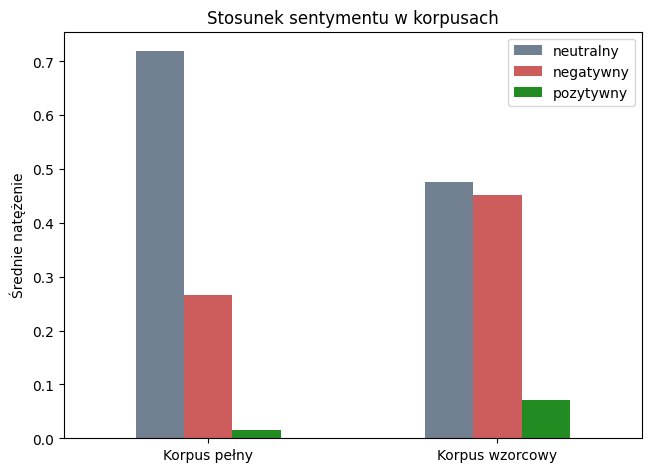

In [122]:
corpora_sent_df.groupby("Corpora").mean().plot(kind="bar", color=["slategray", "indianred", "forestgreen"])
plt.xticks(rotation=0)
plt.tight_layout()
plt.xlabel("")
plt.ylabel("Średnie natężenie")
plt.title("Stosunek sentymentu w korpusach")
plt.show()

## Corpora comparision - wordclouds

In [4]:
from wordcloud import WordCloud
from src.data.pl_stopwords import stopwords

# Create a word cloud image
pl_ann_wc = WordCloud(
    background_color="white",
    max_words=1_000,
    # max_words=500,
    stopwords=set(stopwords),
    width=1_300,
    height=800,
)
pl_ann_wc.generate(" ".join(pl_ann_df["text"].str.lower()))

diabiz_wc = WordCloud(
    background_color="white",
    max_words=1_000,
    # max_words=500,
    stopwords=set(stopwords),
    width=1_300,
    height=800,
)
diabiz_wc.generate(" ".join(diabiz_df["text"].str.lower()))

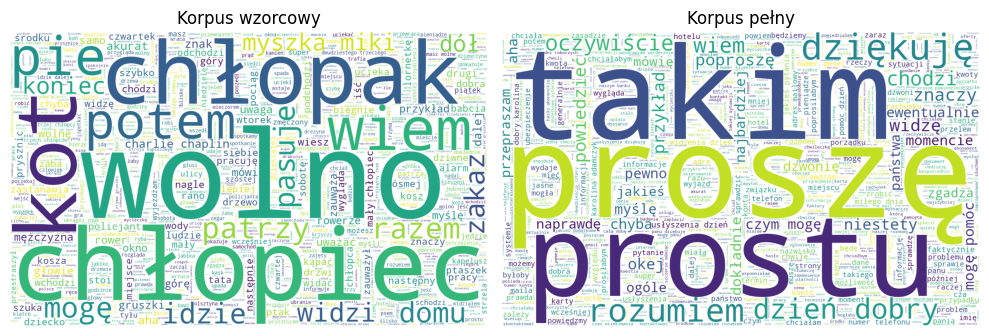

In [5]:
_, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

ax1.imshow(pl_ann_wc)
ax2.imshow(diabiz_wc)
ax1.set_title("Korpus wzorcowy")
ax2.set_title("Korpus pełny")
ax1.axis("off")
ax2.axis("off")

plt.tight_layout()
plt.show()

## Corpora comparision - topics

In [19]:
from bertopic import BERTopic

pl_ann_topic_model = BERTopic("polish")
pl_ann_topics, pl_ann_probs = pl_ann_topic_model.fit_transform(pl_ann_df["text"].tolist())

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

In [20]:
pl_ann_topic_model.visualize_topics()

In [21]:
pl_ann_topic_model.visualize_distribution(pl_ann_probs)

In [22]:
diabiz_topic_model = BERTopic("polish")
diabiz_topics, diabiz_probs = diabiz_topic_model.fit_transform(diabiz_df["text"].tolist())

In [26]:
diabiz_topic_model.visualize_barchart(title="Korpus pełny")

In [27]:
pl_ann_topic_model.visualize_barchart(title="Korpus wzorcowy")